# **BREAST CANCER DETECTION USING CNNs AND TRANSFORMERS**

Author: Lucia Barnuevo Rotaeche *(Last updated: 15/September/2024)*

# **Environment Setup**

The initial stage of the project will entail the implementation and installation of all the requisite libraries. Furthermore, the "Google Drive" application will be mounted, as the project folder will be utilised for the storage of databases. Furthermore, the paths to the dataset directory will be created.

### **Import and install**

In [ ]:
!pip install keras-tuner

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 129.1/129.1 kB 8.1 MB/s eta 0:00:00


In [ ]:
!pip install pydicom

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.9/1.9 MB 63.6 MB/s eta 0:00:00


In [ ]:
!pip install pylibjpeg pylibjpeg-libjpeg

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.4/3.4 MB 87.1 MB/s eta 0:00:00


In [ ]:
!pip install pylibjpeg-openjpeg

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 39.6 MB/s eta 0:00:00


In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import tensorflow as tf
import os
import cv2
import glob
import pathlib
import shutil
from random import sample
import random
from PIL import Image
from google.colab import drive
from sklearn.preprocessing import LabelEncoder
from tensorflow import keras
from tensorflow.keras.optimizers import RMSprop
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras import layers # import the layers module from keras
os.environ['CUDA_VISIBLE_DEVICES'] = '0'  # Specify the ID of the GPU you want to use
from sklearn.metrics import confusion_matrix
import seaborn as sns
from IPython.display import clear_output
from sklearn.model_selection import train_test_split #apply stratified split
from tensorflow.keras.preprocessing.image import ImageDataGenerator #augmentation
from sklearn.preprocessing import LabelEncoder
from tensorflow.keras.utils import to_categorical
import keras_tuner as kt
from sklearn.model_selection import KFold
import pydicom
from sklearn.metrics import classification_report
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
from keras_tuner import HyperParameters as hp

ERROR:pydicom.pixels.utils:No module named 'jpeg_ls'
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/pydicom/pixels/utils.py", line 1274, in _passes_version_check
    module = importlib.import_module(package_name, "__version__")
  File "/usr/lib/python3.10/importlib/__init__.py", line 126, in import_module
    return _bootstrap._gcd_import(name[level:], package, level)
  File "<frozen importlib._bootstrap>", line 1050, in _gcd_import
  File "<frozen importlib._bootstrap>", line 1027, in _find_and_load
  File "<frozen importlib._bootstrap>", line 1004, in _find_and_load_unlocked
ModuleNotFoundError: No module named 'jpeg_ls'
ERROR:pydicom.pixels.utils:No module named 'jpeg_ls'
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/pydicom/pixels/utils.py", line 1274, in _passes_version_check
    module = importlib.import_module(package_name, "__version__")
  File "/usr/lib/python3.10/importlib/__init__.py", line 126, in impo

In [ ]:
tf.test.gpu_device_name()

'/device:GPU:0'

In [ ]:
!nvidia-smi

Mon Sep 16 11:36:46 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  NVIDIA A100-SXM4-40GB          Off | 00000000:00:04.0 Off |                    0 |
| N/A   36C    P0              56W / 400W |    423MiB / 40960MiB |      3%      Default |
|                                         |                      |             Disabled |
+-----------------------------------------+----------------------+--

### **Data loading**

In [ ]:
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
print(os.listdir('/content/drive/MyDrive/TFG'))

['imgs', 'OLD', 'BreastCancerDetection.ipynb', 'Mammogram_databases', 'Copia de Copia de Optimized_BrestCancerDetection.ipynb', 'BC-Ultrasound', 'KCross_BrestCancerDetection.ipynb', 'Optimized_BrestCancerDetection.ipynb']


In [ ]:
base_path = '/content/drive/MyDrive/TFG/BC-Ultrasound'
os.chdir(base_path)

In [ ]:
data = []
class_folders = ['benign', 'malignant', 'normal']

for label, folder in enumerate(class_folders):
    file_paths = glob.glob(f'{base_path}/{folder}/*.png')

    for file_path in file_paths:
        data.append({'file_path': file_path, 'label': label})

df = pd.DataFrame(data)

In [ ]:
data = pd.DataFrame(df)
data

,file_path,label
0,/content/drive/MyDrive/TFG/BC-Ultrasound/benig...,0
1,/content/drive/MyDrive/TFG/BC-Ultrasound/benig...,0
2,/content/drive/MyDrive/TFG/BC-Ultrasound/benig...,0
3,/content/drive/MyDrive/TFG/BC-Ultrasound/benig...,0
4,/content/drive/MyDrive/TFG/BC-Ultrasound/benig...,0
...,...,...
1573,/content/drive/MyDrive/TFG/BC-Ultrasound/norma...,2
1574,/content/drive/MyDrive/TFG/BC-Ultrasound/norma...,2
1575,/content/drive/MyDrive/TFG/BC-Ultrasound/norma...,2
1576,/content/drive/MyDrive/TFG/BC-Ultrasound/norma...,2


In [ ]:
#Image dimensions
img_x = 100
img_y = 100

#Load and resize images

images = []

for value in data["file_path"]:
  img = cv2.imread(value)
  img = cv2.resize(img, (img_x, img_y))
  images.append(img)

In [ ]:
images[0].shape

(100, 100, 3)

In [ ]:
images = np.array(images)

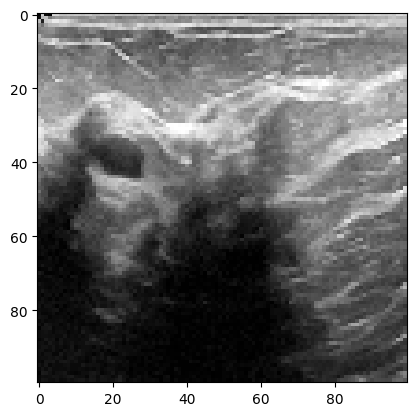

In [ ]:
plt.imshow(images[80])
plt.show()

In [ ]:
label = []

for value in data["label"]:
  label.append(value)

In [ ]:
label = np.array(label)

# Train - validation - test split

In [ ]:
def count_images_per_class(y, dataset_name):
    classes, counts = np.unique(y, return_counts=True)
    print(f"\n{dataset_name} dataset:")
    for cls, count in zip(classes, counts):
        print(f"Class {cls}: {count} images")

def data_augmentation(datagen, images, max_augmented_images):
    augmented_images = []

    for image in images:
        image = image.reshape((1,) + image.shape)
        i = 0

        for augmented_image in datagen.flow(image, batch_size=1):
            augmented_images.append(augmented_image[0])
            i += 1
            if i >= max_augmented_images:
                break
    return np.array(augmented_images)

In [ ]:
x_train_full,x_test,y_train_full,y_test = train_test_split(images, label, test_size=0.2, random_state=49, stratify=label)
x_train, x_val, y_train, y_val = train_test_split(x_train_full, y_train_full, test_size = 0.2, random_state=49, stratify=y_train_full)


print("Train size:", len(x_train))
print("Validation size:", len(x_val))
print("Test size:", len(x_test))

Train size: 1009
Validation size: 253
Test size: 316


In [ ]:
count_images_per_class(y_train, "Training")
count_images_per_class(y_val, "Validation")
count_images_per_class(y_test, "Test")


Training dataset:
Class 0: 569 images
Class 1: 270 images
Class 2: 170 images

Validation dataset:
Class 0: 143 images
Class 1: 67 images
Class 2: 43 images

Test dataset:
Class 0: 179 images
Class 1: 84 images
Class 2: 53 images


### **Data augmentation**

In [ ]:
datagen = ImageDataGenerator (
    rotation_range=30,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.4,
    horizontal_flip=True,
    fill_mode='nearest'
)

datagen_all_training = ImageDataGenerator (
    rotation_range=20,
    width_shift_range=0.1,
    height_shift_range=0.1,
    shear_range=0.1,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest'
)

Performing first data augmentation only on malignant and normal classes to avoid bias towards beningn predictions

In [ ]:
malignant_indices = np.where(y_train == 1)[0]
normal_indices = np.where(y_train == 2)[0]

malignant_images = x_train[malignant_indices]
normal_images = x_train[normal_indices]

Malignant image augmentation (2 transformations per image)

In [ ]:
augmented_malignant_images = data_augmentation(datagen, malignant_images, 2)

Normal image augmentation (3 transformations per image)

In [ ]:
augmented_normal_images = data_augmentation(datagen, normal_images, 3)

In [ ]:
print("Size augmented data: \n(malignant) ", len(augmented_malignant_images), "\n(normal) ", len(augmented_normal_images))

Size augmented data: 
(malignant)  540 
(normal)  510


With a balanced training dataset, augment all images to increase the training dataset size, aiding in model learning and generalization

In [ ]:
x_train = np.concatenate([x_train, augmented_malignant_images, augmented_normal_images], axis=0)
y_train = np.concatenate([y_train, np.ones(len(augmented_malignant_images)), np.full(len(augmented_normal_images), 2)], axis=0)

# augmented_images = data_augmentation(datagen_all_training, x_train, 1)
# x_train = np.concatenate([x_train, augmented_images], axis=0)
# y_train = np.concatenate([y_train, np.zeros(len(augmented_images))], axis=0)

In [ ]:
count_images_per_class(y_train, "Final Training")
count_images_per_class(y_val, "Final Validation")
count_images_per_class(y_test, "Final Test")


Final Training dataset:
Class 0.0: 569 images
Class 1.0: 810 images
Class 2.0: 680 images

Final Validation dataset:
Class 0: 143 images
Class 1: 67 images
Class 2: 43 images

Final Test dataset:
Class 0: 179 images
Class 1: 84 images
Class 2: 53 images


In [ ]:
y_train = to_categorical(y_train, num_classes=3)
y_val = to_categorical(y_val, num_classes=3)
y_test = to_categorical(y_test, num_classes=3)

# **Function definition**


### **Early stopping**

In [ ]:
early_stopping = EarlyStopping(monitor="val_loss", patience=5, restore_best_weights=True, mode='min')

### **Model visualization**

In [ ]:
# For the call back in the epochs
class PlotLearning(keras.callbacks.Callback):
    def __init__(self, num_epochs):
        self.num_epochs = num_epochs

    def on_train_begin(self, logs=None):
        if logs is None:
            logs = {}
        self.metrics = {}

    def on_epoch_end(self, epoch, logs=None):
        if logs is None:
            logs = {}
        # Storing metrics
        for metric in logs:
            if metric in self.metrics:
                self.metrics[metric].append(logs.get(metric))
            else:
                self.metrics[metric] = [logs.get(metric)]

        # Plotting
        metrics = [x for x in logs if 'val' not in x]

        f, axs = plt.subplots(1, len(metrics), figsize=(15, 5))
        clear_output(wait=True)

        for i, metric in enumerate(metrics):
            axs[i].plot(range(1, epoch + 2),
                        self.metrics[metric],
                        label=f'Training {metric.capitalize()}')
            val_metric = 'val_' + metric
            if val_metric in self.metrics:
                axs[i].plot(range(1, epoch + 2),
                            self.metrics[val_metric],
                            label=f'Validation {metric.capitalize()}')

            axs[i].set_title(f'Training and Validation {metric.capitalize()}')
            axs[i].set_xlabel('Epochs')
            axs[i].set_ylabel(metric.capitalize())

            axs[i].legend(loc='best')
            axs[i].grid(True)

        plt.tight_layout()
        plt.show()

In [ ]:
def plot_learning(history):
    metrics = ['accuracy', 'loss']
    f, axs = plt.subplots(1, len(metrics), figsize=(15, 5))
    for i, metric in enumerate(metrics):
        axs[i].plot(history.history[metric], label=f'Training {metric.capitalize()}')
        axs[i].plot(history.history[f'val_{metric}'], label=f'Validation {metric.capitalize()}')
        axs[i].set_title(f'Training and Validation {metric.capitalize()}')
        axs[i].set_xlabel('Epochs')
        axs[i].set_ylabel(metric.capitalize())
        axs[i].legend(loc='best')
        axs[i].grid(True)
    plt.tight_layout()
    plt.show()

def plot_confusion_matrix(model,y_true, y_pred, labels = ['Benign', 'Malignant', 'Normal']):
    # Compute confusion matrix
    confusion_mat = confusion_matrix(y_true, y_pred)

    # Plot the confusion matrix
    plt.figure(figsize=(8, 6))
    sns.heatmap(confusion_mat, annot=True, fmt="g", cmap="Blues", xticklabels=labels, yticklabels=labels)
    plt.title("Confusion Matrix")
    plt.xlabel("Predicted Labels")
    plt.ylabel("True Labels")
    plt.show()

def evaluate_model_predictions(model, images_test, etiquetas_test, class_labels, images_per_row=3):
    # Initialize counters for hits and misses
    hits = 0
    misses = 0

    # Number of images
    num_images = len(images_test)

    # Calculate the number of rows needed
    num_rows = int(np.ceil(num_images / images_per_row))

    # Create a figure with enough subplots to display all images and graphs
    fig, axs = plt.subplots(num_rows, images_per_row * 2, figsize=(images_per_row * 5, num_rows * 5))

    for i in range(num_images):
        # Make a prediction on the i-th image
        image_batchsize = np.expand_dims(images_test[i], axis=0)
        prediction = model.predict(image_batchsize)
        index_max = np.argmax(prediction)
        predicted_label = [0] * len(class_labels)
        predicted_label[index_max] = 1

        # Count hits and misses
        if np.array_equal(predicted_label, etiquetas_test[i]):
            hits += 1
        else:
            misses += 1

        # Obtain the probabilities of belonging to each category and create the graph
        probabilities = prediction[0]
        y_pos = np.arange(len(class_labels))
        sorted_indices = np.argsort(probabilities)[::-1]  # Sort from highest to lowest
        probabilities = probabilities[sorted_indices]
        class_labels_sorted = [class_labels[i] for i in sorted_indices]

        # Determine the row and column for the subplot
        row = i // images_per_row
        col = (i % images_per_row) * 2

        # Show the image and its actual label
        axs[row, col].imshow(images_test[i])
        axs[row, col].set_title(f'Real: {label_to_string(etiquetas_test[i])}\nPredicted: {label_to_string(predicted_label)}')
        axs[row, col].axis('off')

        # Show graph
        axs[row, col + 1].bar(y_pos, probabilities, align='center', alpha=0.5)
        axs[row, col + 1].set_xticks(y_pos)
        axs[row, col + 1].set_xticklabels(class_labels_sorted, rotation=45, ha='right')
        axs[row, col + 1].set_ylabel('Probability')
        axs[row, col + 1].set_title('Probabilities')

    # Remove unused subplots if any
    for j in range(num_images, num_rows * images_per_row):
        row = j // images_per_row
        col = (j % images_per_row) * 2
        axs[row, col].axis('off')
        axs[row, col + 1].axis('off')

    fig.tight_layout()
    plt.show()

    # Show the number of hits and misses
    print(f'Hits: {hits}, Misses: {misses}')

def label_to_string(label):
    labels = ['benign', 'malignant', 'normal']
    return labels[np.argmax(label)]

### **Model definitions**

In [ ]:
def build_robust_model():
  model = keras.Sequential([
      keras.layers.Input(shape=(100, 100, 3)),

      # 2D convolution layer with 128 filters and a 2x2 window with ReLU activation function and the input is a 100x100 pixel colour image
      keras.layers.Conv2D(128, (2, 2), activation='relu'),
      keras.layers.Conv2D(128, (2, 2), activation='relu'),
      # Max pooling layer that halves the image size
      keras.layers.MaxPooling2D((2, 2)),

      # 2D convolution layer with 64 filters and a 2x2 window, followed by another max pooling layer
      keras.layers.Conv2D(64, (2, 2), activation='relu'),
      keras.layers.Conv2D(64, (2, 2), activation='relu'),
      keras.layers.MaxPooling2D((2, 2)),

      # 2D convolution layer with 32 filters and a 2x2 window, followed by another max pooling layer
      keras.layers.Conv2D(32, (2, 2), activation='relu'),
      keras.layers.Conv2D(32, (2, 2), activation='relu'),
      keras.layers.MaxPooling2D((2, 2)),

      # Flattening layer converting the image to a 1D vector
      keras.layers.Flatten(),
      # 64-unit dense layer with ReLU as activation function
      keras.layers.Dense(64, activation='relu'),
      # 10-unit dense layer with softmax activation function
      keras.layers.Dense(3, activation='softmax')
  ])

  # Compile the model for training
  model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.001),
                loss='categorical_crossentropy',
                metrics=['accuracy'])
  return model

def build_model(hp):
    model = keras.Sequential()
    model.add(keras.layers.Input(shape=(100, 100, 3)))

    # Adding convolution layers with a search for the number of layers
    for i in range(hp.Int('num_conv_layers', 1, 8)):
        model.add(keras.layers.Conv2D(
            filters=hp.Int(f'filters_{i}', min_value=32, max_value=256, step=32),
            kernel_size=(3, 3),
            activation='relu',
            kernel_regularizer=keras.regularizers.l2(1e-4),  # L2 Regularization
            padding='same'
        ))
        model.add(keras.layers.MaxPooling2D((2, 2)))

    model.add(keras.layers.Flatten())
    model.add(keras.layers.Dense(
        units=hp.Int('dense_units', min_value=32, max_value=128, step=32),
        activation='relu'
    ))

    # Add dropout to the fully connected layer with a search for the dropout rate
    model.add(keras.layers.Dropout(hp.Float('dense_dropout', min_value=0.3, max_value=0.8, step=0.1)))

    # Output layer with 3 classes
    model.add(keras.layers.Dense(3, activation='softmax'))

    # Compile the model
    model.compile(
        optimizer=keras.optimizers.Adam(hp.Choice('learning_rate', [1e-2, 1e-3, 1e-4, 1e-5])),
        loss='categorical_crossentropy',
        metrics=['accuracy']
    )

    return model

def transformer_model(input_shape=(100, 100, 3), num_heads=4, ff_dim=32):
    inputs = keras.layers.Input(shape=input_shape)

    # Patch creation
    patches = keras.layers.Conv2D(32, (3, 3), strides=(2, 2), padding='same')(inputs)

    # Flatten only the spatial dimensions, not the batch or channels
    patches_shape = keras.layers.Reshape((-1, patches.shape[-1]))(patches)  # Dynamically determine channels

    # Positional encoding
    positions = np.arange(0, patches_shape.shape[1], dtype=int)
    positions = keras.layers.Embedding(input_dim=patches_shape.shape[1], output_dim=patches_shape.shape[-1])(positions)

    x = patches_shape + positions

    # Transformer blocks
    for _ in range(2):
        x = layers.MultiHeadAttention(num_heads=num_heads, key_dim=patches_shape.shape[-1])(x, x)
        x = layers.LayerNormalization(epsilon=1e-6)(x)
        x = keras.layers.Dense(ff_dim, activation="relu")(x)
        x = layers.LayerNormalization(epsilon=1e-6)(x)

    # Flatten the output and add a dense layer
    x = keras.layers.Flatten()(x)
    x = keras.layers.Dense(64, activation='relu')(x)
    outputs = keras.layers.Dense(3, activation='softmax')(x)

    return keras.Model(inputs, outputs)


# Configure Keras Tuner for Transformers model optimization
def build_transformer_model(hp):
    model = transformer_model(
        num_heads=hp.Int('num_heads', 2, 10, step=2),
        ff_dim=hp.Int('ff_dim', 32, 128, step=32)
    )
    model.compile(
        optimizer=keras.optimizers.Adam(hp.Choice('learning_rate',[1e-2, 1e-3, 1e-4])),
        loss='categorical_crossentropy',
        metrics=['accuracy']
    )
    return model

### **Optimizacion tuner initialization**

In [ ]:
!rm -rf keras_tuner_dir

In [ ]:
tuner_model = kt.Hyperband(
    build_model,
    objective='val_accuracy',
    max_epochs=50,
    factor=3,
    directory='keras_tuner_dir',
    project_name='breast_cancer_detection_optimization'
)

tuner_transformer = kt.Hyperband(
    build_transformer_model,
    objective='val_accuracy',
    max_epochs=50,
    factor=3,
    directory='keras_tuner_dir',
    project_name='breast_cancer_detection_transformer'
)

Reloading Tuner from keras_tuner_dir/breast_cancer_detection_transformer/tuner0.json


# **Model training and evalutation**

### **Robust model (no hyperparameter optimization)**

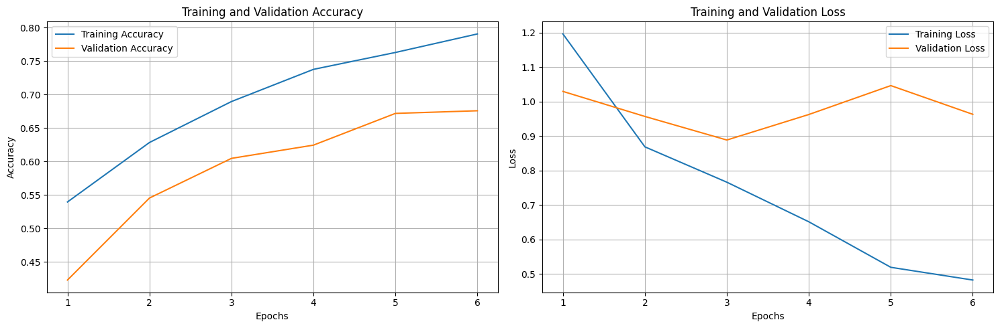

65/65 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - accuracy: 0.7995 - loss: 0.4746 - val_accuracy: 0.6759 - val_loss: 0.9632


In [ ]:
num_epochs = 20

modelo_no_hyper = build_robust_model()
history = modelo_no_hyper.fit(x_train, y_train, epochs=num_epochs, batch_size=32, validation_data=(x_val, y_val),callbacks=[PlotLearning(num_epochs), early_stopping])

In [ ]:
y_pred_probs = modelo_no_hyper.predict(x_test)
y_pred = np.argmax(y_pred_probs, axis=1)
y_true = np.argmax(y_test, axis=1)

10/10 ━━━━━━━━━━━━━━━━━━━━ 1s 104ms/step


In [ ]:
test_loss, test_accuracy = modelo_no_hyper.evaluate(x_test, y_test)

10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step - accuracy: 0.4936 - loss: 0.9848


In [ ]:
report = classification_report(y_true, y_pred, target_names=['Benign', 'Malignant', 'Normal'])
print("Classification Report:\n", report)

Classification Report:
               precision    recall  f1-score   support

      Benign       0.82      0.27      0.41       179
   Malignant       0.44      0.55      0.49        84
      Normal       0.33      0.94      0.49        53

    accuracy                           0.46       316
   macro avg       0.53      0.59      0.46       316
weighted avg       0.63      0.46      0.44       316



In [ ]:
evaluate_model_predictions(modelo_no_hyper, x_test, y_test, class_labels=['Benign', 'Malignant', 'Normal'])

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 470ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━

Hits: 145, Misses: 171


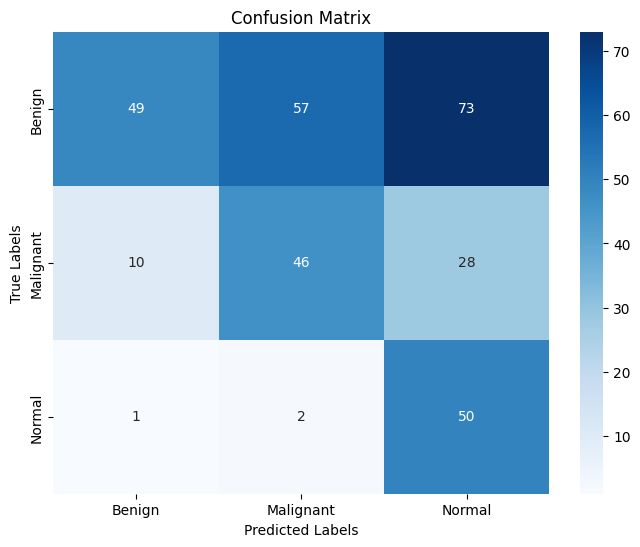

In [ ]:
plot_confusion_matrix(modelo_no_hyper, y_true, y_pred)

### **Model with hyperparameter optimization**

In [ ]:
# Search for hyperparameters
tuner_model.search(x_train, y_train, epochs=20, validation_data=(x_val, y_val), batch_size=kt.HyperParameters().Int('batch_size', min_value=16, max_value=128, step=16), callbacks=[early_stopping])

# Obtain best model and train it
best_hps = tuner_model.get_best_hyperparameters(num_trials=1)[0]

print("Best hyperparameters found:")
print(f"Number of convolution layers: {best_hps.get('num_conv_layers')}")
for i in range(best_hps.get('num_conv_layers')):
    print(f"Filters in convolution layer {i}: {best_hps.get(f'filters_{i}')}")
print(f"Units in dense layer: {best_hps.get('dense_units')}")
print(f"Dropout rate in dense layer: {best_hps.get('dense_dropout')}")
print(f"Learning rate: {best_hps.get('learning_rate')}")

tuner_model.results_summary()

Trial 67 Complete [00h 00m 17s]
val_accuracy: 0.6007905006408691

Best val_accuracy So Far: 0.7588932514190674
Total elapsed time: 00h 12m 00s
Best hyperparameters found:
Number of convolution layers: 6
Filters in convolution layer 0: 32
Filters in convolution layer 1: 64
Filters in convolution layer 2: 128
Filters in convolution layer 3: 256
Filters in convolution layer 4: 224
Filters in convolution layer 5: 96
Units in dense layer: 96
Dropout rate in dense layer: 0.4
Learning rate: 1e-05
Results summary
Results in keras_tuner_dir/breast_cancer_detection_optimization
Showing 10 best trials
Objective(name="val_accuracy", direction="max")

Trial 0061 summary
Hyperparameters:
num_conv_layers: 6
filters_0: 32
dense_units: 96
dense_dropout: 0.4
learning_rate: 1e-05
filters_1: 64
filters_2: 128
filters_3: 256
filters_4: 224
filters_5: 96
filters_6: 32
filters_7: 64
tuner/epochs: 50
tuner/initial_epoch: 17
tuner/bracket: 1
tuner/round: 1
tuner/trial_id: 0053
Score: 0.7588932514190674

Trial 

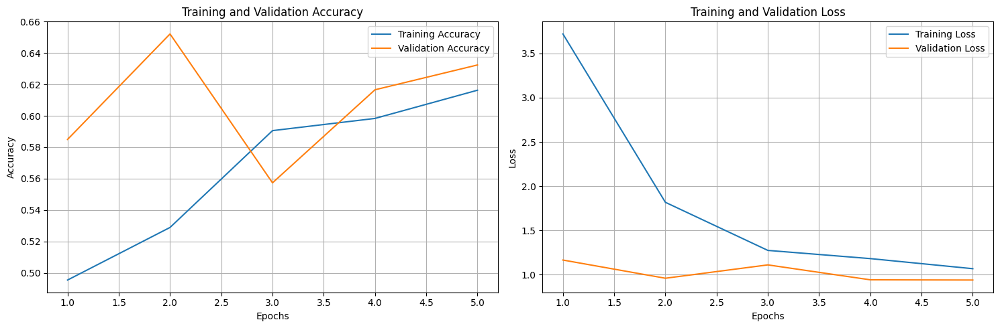

65/65 ━━━━━━━━━━━━━━━━━━━━ 1s 13ms/step - accuracy: 0.6143 - loss: 1.0684 - val_accuracy: 0.6324 - val_loss: 0.9400


In [ ]:
model_hps = tuner_model.hypermodel.build(best_hps)
history = model_hps.fit(x_train, y_train, epochs=20, batch_size=32, validation_data=(x_val, y_val), callbacks=[PlotLearning(num_epochs), early_stopping])

In [ ]:
y_pred_probs_hps = model_hps.predict(x_test)
y_pred_hps = np.argmax(y_pred_probs_hps, axis=1)
y_true = np.argmax(y_test, axis=1)

10/10 ━━━━━━━━━━━━━━━━━━━━ 2s 127ms/step


In [ ]:
model_hps.evaluate(x_test, y_test)

10/10 ━━━━━━━━━━━━━━━━━━━━ 1s 96ms/step - accuracy: 0.5900 - loss: 1.1821


[1.2261240482330322, 0.5791139006614685]

In [ ]:
report_hps = classification_report(y_true, y_pred_hps, target_names=['Benign', 'Malignant', 'Normal'])
print("Classification Report:\n", report_hps)

Classification Report:
               precision    recall  f1-score   support

      Benign       0.72      0.54      0.62       179
   Malignant       0.40      0.65      0.50        84
      Normal       0.68      0.60      0.64        53

    accuracy                           0.58       316
   macro avg       0.60      0.60      0.59       316
weighted avg       0.63      0.58      0.59       316



In [ ]:
evaluate_model_predictions(model_hps, x_test, y_test, class_labels=['Benign', 'Malignant', 'Normal'])

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 503ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━

Hits: 183, Misses: 133


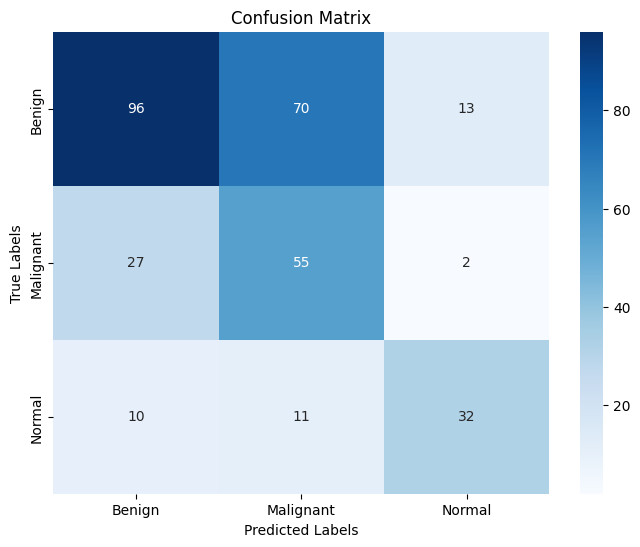

In [ ]:
plot_confusion_matrix(model_hps, y_true, y_pred_hps)

### **Transformers model**

In [ ]:
# Search for hyperparameters
tuner_transformer.search(x_train, y_train, epochs=20, validation_data=(x_val, y_val), batch_size=kt.HyperParameters().Int('batch_size', min_value=16, max_value=64, step=16), callbacks=[early_stopping])

# Obtain best model and train it
best_hps_transformer = tuner_transformer.get_best_hyperparameters(num_trials=1)[0]

print("Best hyperparameters found:")
print(f"Number of attention heads: {best_hps_transformer.get('num_heads')}")
print(f"Feed-forward dimension: {best_hps_transformer.get('ff_dim')}")
print(f"Learning rate: {best_hps_transformer.get('learning_rate')}")

tuner_transformer.results_summary()

In [ ]:
num_epochs = 20

model_transformers = tuner_transformer.hypermodel.build(best_hps_transformer)
history = model_transformers.fit(x_train, y_train, epochs=20, batch_size=32, validation_data=(x_val, y_val), callbacks=[PlotLearning(num_epochs), early_stopping])

In [ ]:
y_pred_probs_transf = model_transformers.predict(x_test)
y_pred_transf = np.argmax(y_pred_probs_transf, axis=1)
y_true = np.argmax(y_test, axis=1)

In [ ]:
model_transformers.evaluate(x_test, y_test)

In [ ]:
report_transf = classification_report(y_true, y_pred_transf, target_names=['Benign', 'Malignant', 'Normal'])
print("Classification Report:\n", report_transf)

Classification Report:
               precision    recall  f1-score   support

      Benign       0.65      0.39      0.48       179
   Malignant       0.30      0.44      0.36        84
      Normal       0.45      0.75      0.57        53

    accuracy                           0.46       316
   macro avg       0.47      0.53      0.47       316
weighted avg       0.53      0.46      0.46       316



In [ ]:
evaluate_model_predictions(model_transformers, x_test, y_test, class_labels=['Benign', 'Malignant', 'Normal'])

1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━

Hits: 146, Misses: 170


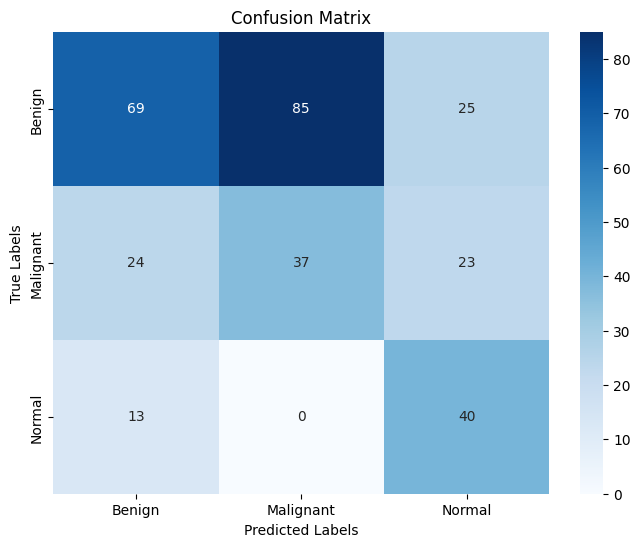

In [ ]:
plot_confusion_matrix(model_transformers, y_true, y_pred_transf)

# K-fold cross validation

In [ ]:
kf = KFold(n_splits=5, shuffle=True, random_state=42)

### **Robust model**

In [ ]:
accuracy_per_fold = []
loss_per_fold = []

for fold, (train_idx, val_idx) in enumerate(kf.split(images)):
    print(f"Fold {fold + 1}/{kf.get_n_splits()}")

    X_train, X_val = images[train_idx], images[val_idx]
    y_train, y_val = label[train_idx], label[val_idx]

    y_train_cat = tf.keras.utils.to_categorical(y_train, 3)
    y_val_cat = tf.keras.utils.to_categorical(y_val, 3)

    # Build and train model
    model = build_robust_model()
    history = model.fit(X_train, y_train_cat, validation_data=(X_val, y_val_cat), epochs=20, batch_size=32, callbacks=[early_stopping])

    # Model evaluation
    y_val_pred = model.predict(X_val)
    y_val_pred_labels = np.argmax(y_val_pred, axis=1)

    # Accuracy
    accuracy = accuracy_score(y_val, y_val_pred_labels)
    accuracy_per_fold.append(accuracy)

    # Loss
    val_loss = history.history['val_loss'][-1]
    loss_per_fold.append(val_loss)

    print(f"Accuracy in fold {fold + 1}: {accuracy:.4f}")
    print(f"Loss in fold {fold + 1}: {val_loss:.4f}")

mean_accuracy = np.mean(accuracy_per_fold)
mean_loss = np.mean(loss_per_fold)

print(f"Mean accuracy in K-Fold: {mean_accuracy:.4f} (+/- {np.std(accuracy_per_fold)})")
print(f"Mean loss in K-Fold: {mean_loss:.4f} (+/- {np.std(loss_per_fold)})")

Fold 1/5
Epoch 1/20
40/40 ━━━━━━━━━━━━━━━━━━━━ 8s 111ms/step - accuracy: 0.4892 - loss: 2.4278 - val_accuracy: 0.7057 - val_loss: 0.7750
Epoch 2/20
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - accuracy: 0.6453 - loss: 0.7928 - val_accuracy: 0.6962 - val_loss: 0.7240
Epoch 3/20
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - accuracy: 0.7105 - loss: 0.6718 - val_accuracy: 0.7120 - val_loss: 0.6653
Epoch 4/20
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - accuracy: 0.7524 - loss: 0.5524 - val_accuracy: 0.7373 - val_loss: 0.7360
Epoch 5/20
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - accuracy: 0.7583 - loss: 0.5290 - val_accuracy: 0.7247 - val_loss: 0.7618
10/10 ━━━━━━━━━━━━━━━━━━━━ 1s 37ms/step
Accuracy in fold 1: 0.7057
Loss in fold 1: 0.7618
Fold 2/5
Epoch 1/20
40/40 ━━━━━━━━━━━━━━━━━━━━ 7s 79ms/step - accuracy: 0.4720 - loss: 2.3899 - val_accuracy: 0.6266 - val_loss: 0.8627
Epoch 2/20
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - accuracy: 0.6982 - loss: 0.7662 - val_accuracy: 0.6487 - val_loss: 0.8943
Epo

### **Model with hyperparameter optimization**

In [ ]:
accuracy_per_fold_hps = []
loss_per_fold_hps = []

for fold, (train_idx, val_idx) in enumerate(kf.split(images)):
    print(f"Fold {fold + 1}/{kf.get_n_splits()}")

    X_train, X_val = images[train_idx], images[val_idx]
    y_train, y_val = label[train_idx], label[val_idx]

    y_train_cat = tf.keras.utils.to_categorical(y_train, 3)
    y_val_cat = tf.keras.utils.to_categorical(y_val, 3)

    # Hyperparameter search for fold
    tuner_fold = kt.Hyperband(
        build_model,
        objective='val_accuracy',
        max_epochs=50,
        factor=3,
        directory=f'keras_tuner_dir_fold_{fold}',
        project_name=f'breast_cancer_fold_{fold}'
    )

    tuner_fold.search(X_train, y_train_cat, epochs=10, validation_data=(X_val, y_val_cat), callbacks=[early_stopping])

    best_hps = tuner_fold.get_best_hyperparameters(num_trials=1)[0]
    model = tuner_fold.hypermodel.build(best_hps)

    # Model training
    history = model.fit(X_train, y_train_cat, validation_data=(X_val, y_val_cat),
                        epochs=20, batch_size=32, callbacks=[early_stopping])

    # Metrics
    y_val_pred = np.argmax(model.predict(X_val), axis=1)
    accuracy = accuracy_score(y_val, y_val_pred)
    loss = history.history['val_loss'][-1]

    accuracy_per_fold_hps.append(accuracy)
    loss_per_fold_hps.append(loss)

    print(f"Accuracy in fold {fold + 1}: {accuracy:.4f}")
    print(f"Loss in fold {fold + 1}: {loss:.4f}")

mean_accuracy_hps = np.mean(accuracy_per_fold_hps)
mean_loss_hps = np.mean(loss_per_fold_hps)

print(f"Mean accuracy in K-Fold: {mean_accuracy_hps:.4f} (+/- {np.std(accuracy_per_fold_hps)})")
print(f"Mean loss in K-Fold: {mean_loss_hps:.4f} (+/- {np.std(loss_per_fold_hps)})")

Fold 1/5
Reloading Tuner from keras_tuner_dir_fold_0/breast_cancer_fold_0/tuner0.json
Epoch 1/20
40/40 ━━━━━━━━━━━━━━━━━━━━ 7s 105ms/step - accuracy: 0.5186 - loss: 96.8196 - val_accuracy: 0.4367 - val_loss: 2.1613
Epoch 2/20
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - accuracy: 0.4725 - loss: 1.2371 - val_accuracy: 0.6646 - val_loss: 1.2255
Epoch 3/20
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - accuracy: 0.6522 - loss: 1.0781 - val_accuracy: 0.6772 - val_loss: 1.0354
Epoch 4/20
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - accuracy: 0.6471 - loss: 0.8614 - val_accuracy: 0.6646 - val_loss: 1.0846
Epoch 5/20
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - accuracy: 0.6739 - loss: 0.7974 - val_accuracy: 0.6677 - val_loss: 1.1234
Epoch 6/20
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - accuracy: 0.6859 - loss: 0.7931 - val_accuracy: 0.6930 - val_loss: 0.9438
10/10 ━━━━━━━━━━━━━━━━━━━━ 1s 39ms/step
Accuracy in fold 1: 0.4367
Loss in fold 1: 0.9438
Fold 2/5
Reloading Tuner from keras_tuner_dir_fold_1/breast_cance

### **Transformers model**

In [ ]:
accuracy_per_fold_transf = []
loss_per_fold_transf = []

for fold, (train_idx, val_idx) in enumerate(kf.split(images)):
    print(f"Fold {fold + 1}/{kf.get_n_splits()}")

    X_train, X_val = images[train_idx], images[val_idx]
    y_train, y_val = label[train_idx], label[val_idx]

    y_train_cat = tf.keras.utils.to_categorical(y_train, 3)
    y_val_cat = tf.keras.utils.to_categorical(y_val, 3)

    # Hyperparameter search
    tuner_transformer_fold = kt.Hyperband(
        build_transformer_model,
        objective='val_accuracy',
        max_epochs=50,
        factor=3,
        directory=f'keras_tuner_dir_transformer_fold_{fold}',
        project_name=f'breast_cancer_transformer_fold_{fold}'
    )

    tuner_transformer_fold.search(X_train, y_train_cat, epochs=10, validation_data=(X_val, y_val_cat), callbacks=[early_stopping])

    best_hps_transformer = tuner_transformer_fold.get_best_hyperparameters(num_trials=1)[0]
    model_transformer = tuner_transformer_fold.hypermodel.build(best_hps_transformer)

    # Model training
    history_transformer = model_transformer.fit(X_train, y_train_cat, validation_data=(X_val, y_val_cat),
                                                epochs=20, batch_size=32, callbacks=[early_stopping])

    # Metrics
    y_val_pred_transformer = np.argmax(model_transformer.predict(X_val), axis=1)
    accuracy_transformer = accuracy_score(y_val, y_val_pred_transformer)
    loss_transformer = history_transformer.history['val_loss'][-1]

    accuracy_per_fold_transf.append(accuracy_transformer)
    loss_per_fold_transf.append(loss_transformer)

    print(f"Accuracy in fold {fold + 1}: {accuracy_transformer:.4f}")
    print(f"Loss in fold {fold + 1}: {loss_transformer:.4f}")

mean_accuracy_transformer = np.mean(accuracy_per_fold_transf)
mean_loss_transformer = np.mean(loss_per_fold_transf)

print(f"Mean accuracy in K-Fold: {mean_accuracy_transformer:.4f} (+/- {np.std(accuracy_per_fold_transf)})")
print(f"Mean accuracy in K-Fold: {mean_loss_transformer:.4f} (+/- {np.std(loss_per_fold_transf)})")


Trial 15 Complete [00h 00m 24s]

Best val_accuracy So Far: 0.6835442781448364
Total elapsed time: 00h 10m 21s

Search: Running Trial #16

Value             |Best Value So Far |Hyperparameter
8                 |4                 |num_heads
96                |128               |ff_dim
0.01              |0.01              |learning_rate
2                 |2                 |tuner/epochs
0                 |0                 |tuner/initial_epoch
3                 |3                 |tuner/bracket
0                 |0                 |tuner/round

Epoch 1/2


Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/keras_tuner/src/engine/base_tuner.py", line 274, in _try_run_and_update_trial
    self._run_and_update_trial(trial, *fit_args, **fit_kwargs)
  File "/usr/local/lib/python3.10/dist-packages/keras_tuner/src/engine/base_tuner.py", line 239, in _run_and_update_trial
    results = self.run_trial(trial, *fit_args, **fit_kwargs)
  File "/usr/local/lib/python3.10/dist-packages/keras_tuner/src/tuners/hyperband.py", line 427, in run_trial
    return super().run_trial(trial, *fit_args, **fit_kwargs)
  File "/usr/local/lib/python3.10/dist-packages/keras_tuner/src/engine/tuner.py", line 314, in run_trial
    obj_value = self._build_and_fit_model(trial, *args, **copied_kwargs)
  File "/usr/local/lib/python3.10/dist-packages/keras_tuner/src/engine/tuner.py", line 233, in _build_and_fit_model
    results = self.hypermodel.fit(hp, model, *args, **kwargs)
  File "/usr/local/lib/python3.10/dist-packages/keras_tuner/src/eng

RuntimeError: Number of consecutive failures exceeded the limit of 3.
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/keras_tuner/src/engine/base_tuner.py", line 274, in _try_run_and_update_trial
    self._run_and_update_trial(trial, *fit_args, **fit_kwargs)
  File "/usr/local/lib/python3.10/dist-packages/keras_tuner/src/engine/base_tuner.py", line 239, in _run_and_update_trial
    results = self.run_trial(trial, *fit_args, **fit_kwargs)
  File "/usr/local/lib/python3.10/dist-packages/keras_tuner/src/tuners/hyperband.py", line 427, in run_trial
    return super().run_trial(trial, *fit_args, **fit_kwargs)
  File "/usr/local/lib/python3.10/dist-packages/keras_tuner/src/engine/tuner.py", line 314, in run_trial
    obj_value = self._build_and_fit_model(trial, *args, **copied_kwargs)
  File "/usr/local/lib/python3.10/dist-packages/keras_tuner/src/engine/tuner.py", line 233, in _build_and_fit_model
    results = self.hypermodel.fit(hp, model, *args, **kwargs)
  File "/usr/local/lib/python3.10/dist-packages/keras_tuner/src/engine/hypermodel.py", line 149, in fit
    return model.fit(*args, **kwargs)
  File "/usr/local/lib/python3.10/dist-packages/keras/src/utils/traceback_utils.py", line 122, in error_handler
    raise e.with_traceback(filtered_tb) from None
  File "/usr/local/lib/python3.10/dist-packages/tensorflow/python/eager/execute.py", line 53, in quick_execute
    tensors = pywrap_tfe.TFE_Py_Execute(ctx._handle, device_name, op_name,
tensorflow.python.framework.errors_impl.ResourceExhaustedError: Graph execution error:

Detected at node StatefulPartitionedCall defined at (most recent call last):
  File "/usr/lib/python3.10/runpy.py", line 196, in _run_module_as_main

  File "/usr/lib/python3.10/runpy.py", line 86, in _run_code

  File "/usr/local/lib/python3.10/dist-packages/colab_kernel_launcher.py", line 37, in <module>

  File "/usr/local/lib/python3.10/dist-packages/traitlets/config/application.py", line 992, in launch_instance

  File "/usr/local/lib/python3.10/dist-packages/ipykernel/kernelapp.py", line 619, in start

  File "/usr/local/lib/python3.10/dist-packages/tornado/platform/asyncio.py", line 195, in start

  File "/usr/lib/python3.10/asyncio/base_events.py", line 603, in run_forever

  File "/usr/lib/python3.10/asyncio/base_events.py", line 1909, in _run_once

  File "/usr/lib/python3.10/asyncio/events.py", line 80, in _run

  File "/usr/local/lib/python3.10/dist-packages/tornado/ioloop.py", line 685, in <lambda>

  File "/usr/local/lib/python3.10/dist-packages/tornado/ioloop.py", line 738, in _run_callback

  File "/usr/local/lib/python3.10/dist-packages/tornado/gen.py", line 825, in inner

  File "/usr/local/lib/python3.10/dist-packages/tornado/gen.py", line 786, in run

  File "/usr/local/lib/python3.10/dist-packages/ipykernel/kernelbase.py", line 361, in process_one

  File "/usr/local/lib/python3.10/dist-packages/tornado/gen.py", line 234, in wrapper

  File "/usr/local/lib/python3.10/dist-packages/ipykernel/kernelbase.py", line 261, in dispatch_shell

  File "/usr/local/lib/python3.10/dist-packages/tornado/gen.py", line 234, in wrapper

  File "/usr/local/lib/python3.10/dist-packages/ipykernel/kernelbase.py", line 539, in execute_request

  File "/usr/local/lib/python3.10/dist-packages/tornado/gen.py", line 234, in wrapper

  File "/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py", line 302, in do_execute

  File "/usr/local/lib/python3.10/dist-packages/ipykernel/zmqshell.py", line 539, in run_cell

  File "/usr/local/lib/python3.10/dist-packages/IPython/core/interactiveshell.py", line 2975, in run_cell

  File "/usr/local/lib/python3.10/dist-packages/IPython/core/interactiveshell.py", line 3030, in _run_cell

  File "/usr/local/lib/python3.10/dist-packages/IPython/core/async_helpers.py", line 78, in _pseudo_sync_runner

  File "/usr/local/lib/python3.10/dist-packages/IPython/core/interactiveshell.py", line 3257, in run_cell_async

  File "/usr/local/lib/python3.10/dist-packages/IPython/core/interactiveshell.py", line 3473, in run_ast_nodes

  File "/usr/local/lib/python3.10/dist-packages/IPython/core/interactiveshell.py", line 3553, in run_code

  File "<ipython-input-46-2443aacc07e3>", line 23, in <cell line: 4>

  File "/usr/local/lib/python3.10/dist-packages/keras_tuner/src/engine/base_tuner.py", line 234, in search

  File "/usr/local/lib/python3.10/dist-packages/keras_tuner/src/engine/base_tuner.py", line 274, in _try_run_and_update_trial

  File "/usr/local/lib/python3.10/dist-packages/keras_tuner/src/engine/base_tuner.py", line 239, in _run_and_update_trial

  File "/usr/local/lib/python3.10/dist-packages/keras_tuner/src/tuners/hyperband.py", line 427, in run_trial

  File "/usr/local/lib/python3.10/dist-packages/keras_tuner/src/engine/tuner.py", line 314, in run_trial

  File "/usr/local/lib/python3.10/dist-packages/keras_tuner/src/engine/tuner.py", line 233, in _build_and_fit_model

  File "/usr/local/lib/python3.10/dist-packages/keras_tuner/src/engine/hypermodel.py", line 149, in fit

  File "/usr/local/lib/python3.10/dist-packages/keras/src/utils/traceback_utils.py", line 117, in error_handler

  File "/usr/local/lib/python3.10/dist-packages/keras/src/backend/tensorflow/trainer.py", line 318, in fit

  File "/usr/local/lib/python3.10/dist-packages/keras/src/backend/tensorflow/trainer.py", line 121, in one_step_on_iterator

Out of memory while trying to allocate 26273769744 bytes.
	 [[{{node StatefulPartitionedCall}}]]
Hint: If you want to see a list of allocated tensors when OOM happens, add report_tensor_allocations_upon_oom to RunOptions for current allocation info. This isn't available when running in Eager mode.
 [Op:__inference_one_step_on_iterator_188631]
